In [18]:
import glob
import os
from pathlib import Path
from PIL import Image
import torch
import clip
from multimodal.multimodal_saycam_data_module import LABELED_S_DIRNAME, FILTERED_LABELED_S_DIRNAME

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [2]:
eval_categories = sorted(os.listdir(LABELED_S_DIRNAME))
eval_categories.remove("carseat")
eval_categories.remove("couch")
eval_categories.remove("greenery")
eval_categories.remove("plushanimal")

# create directories
os.makedirs(FILTERED_LABELED_S_DIRNAME, exist_ok=True)
for eval_category in eval_categories:
    os.makedirs(Path(FILTERED_LABELED_S_DIRNAME) /
                eval_category, exist_ok=True)

# load CLIP model
model, preprocess = clip.load("ViT-B/16", device=device)
model.eval()

# get CLIP text embedding for eval categories
texts = clip.tokenize(
    [f'{category}' for category in eval_categories]).to(device)
text_features = model.encode_text(texts).float()
sims = []

for i, eval_category in enumerate(eval_categories):
    # get frames for each evaluation category
    eval_category_dir = os.path.join(LABELED_S_DIRNAME, eval_category)
    frames = glob.glob(f"{eval_category_dir}/*.jpeg")
    print(
        f"Filtering {len(frames)} from the category: {eval_category}")

    count = 0

    for frame in frames:
        # load and encode image via CLIP
        I = Image.open(frame).convert("RGB")
        image = preprocess(I).unsqueeze(0).to(device)
        image_features = model.encode_image(image).float()
        
        sim = (image_features.squeeze() @ text_features[i]).item()
        sims.append([eval_category, frame, sim])

Filtering 4213 from the category: ball
Filtering 148 from the category: basket
Filtering 1291 from the category: car
Filtering 1503 from the category: cat
Filtering 1070 from the category: chair
Filtering 1681 from the category: computer
Filtering 919 from the category: crib
Filtering 2535 from the category: door
Filtering 5436 from the category: floor
Filtering 815 from the category: foot
Filtering 2181 from the category: ground
Filtering 3093 from the category: hand
Filtering 2159 from the category: kitchen
Filtering 1431 from the category: paper
Filtering 3058 from the category: puzzle
Filtering 3481 from the category: road
Filtering 3958 from the category: room
Filtering 636 from the category: sand
Filtering 954 from the category: stairs
Filtering 2647 from the category: table
Filtering 8614 from the category: toy
Filtering 2377 from the category: window


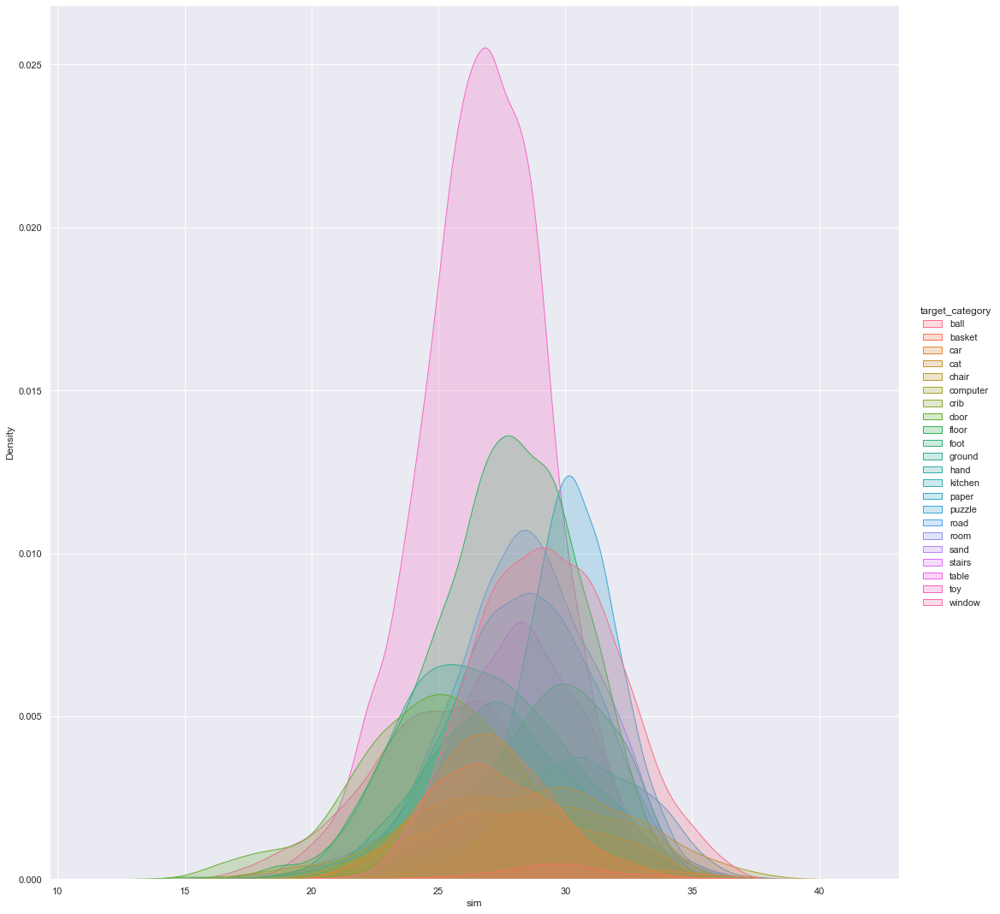

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

sns.set(rc = {'figure.figsize':(40, 40)})
sims_df = pd.DataFrame(sims, columns=["target_category", "frame", "sim"])
sns.displot(sims_df, x="sim", hue="target_category", kind="kde", fill=True, height=15)


ball 4213
basket 148
car 1291
cat 1503
chair 1070
computer 1681
crib 919
door 2535
floor 5436
foot 815
ground 2181
hand 3093
kitchen 2159
paper 1431
puzzle 3058
road 3481
room 3958
sand 636
stairs 954
table 2647
toy 8614


/tmp/ipykernel_30439/1587677011.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(25, 12))


window 2377


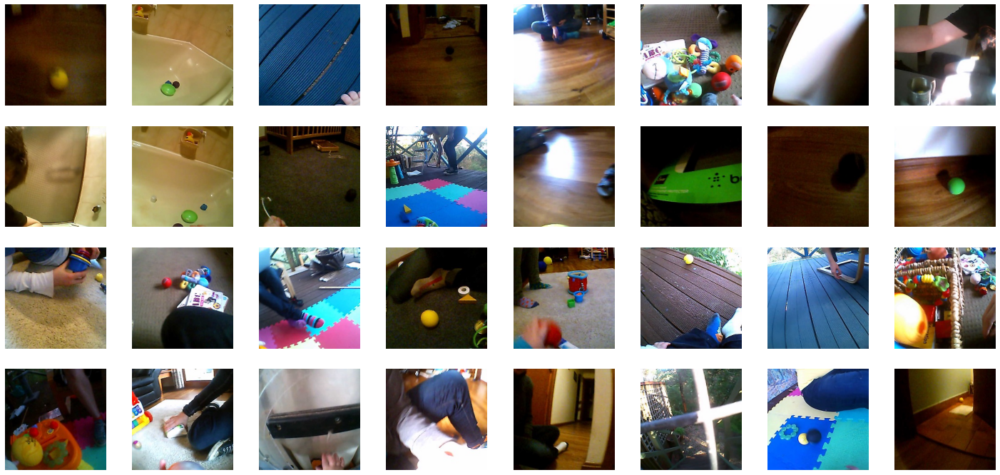

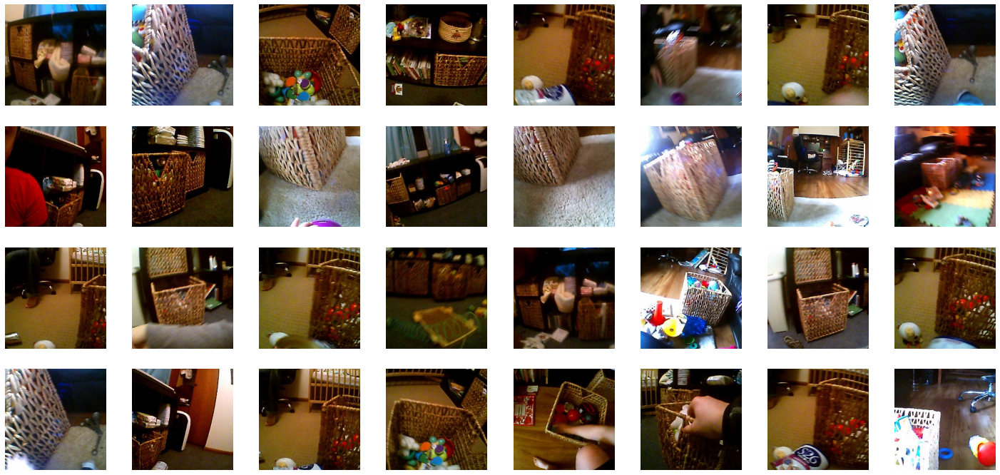

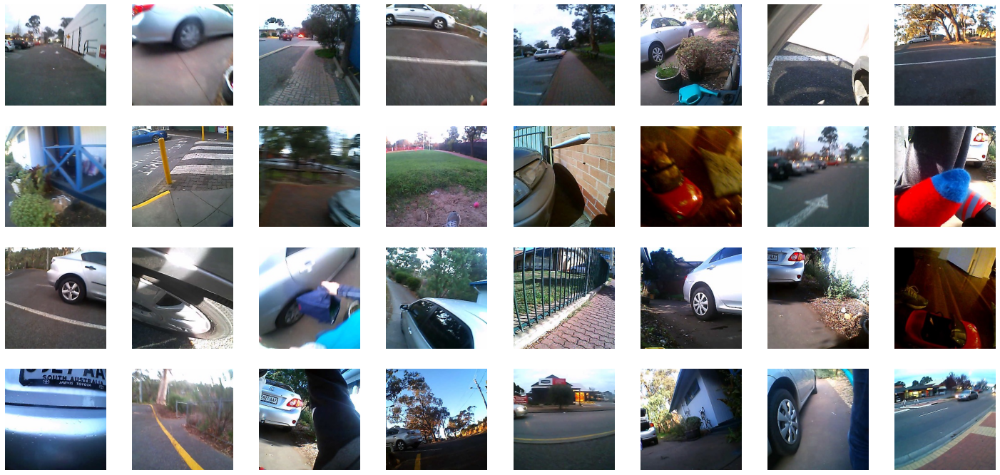

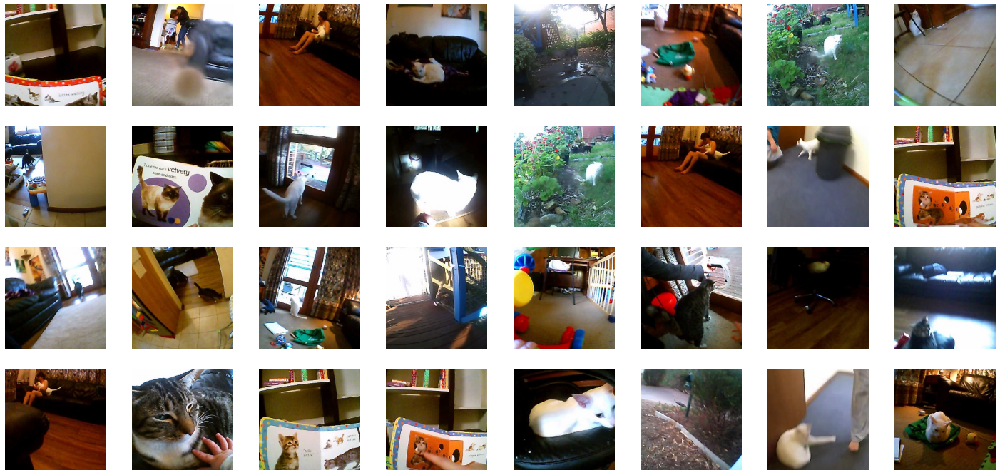

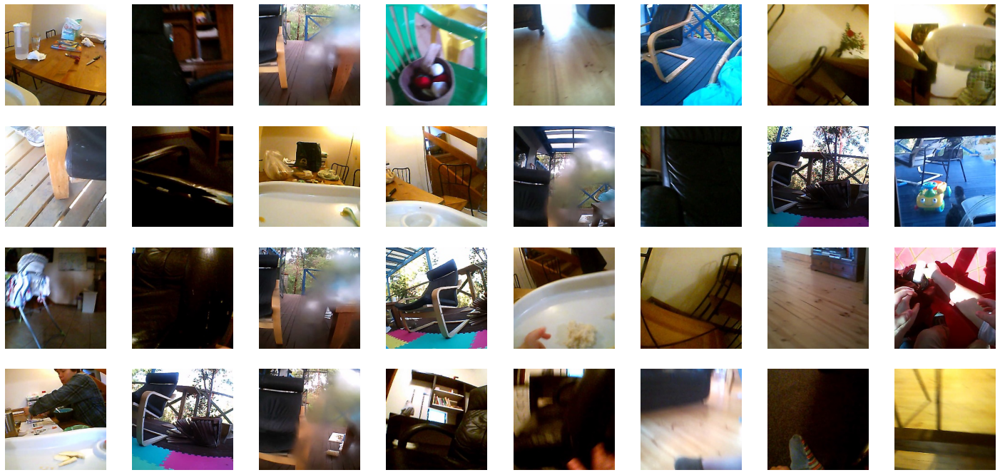

...

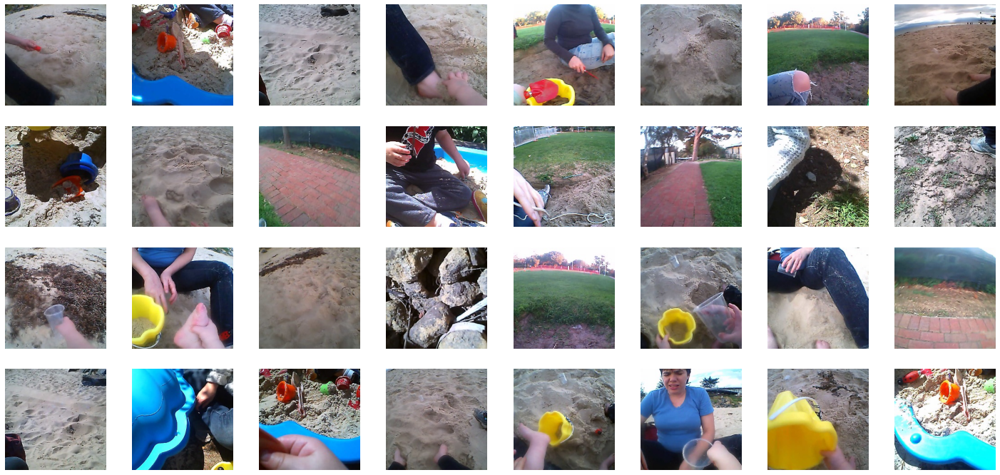

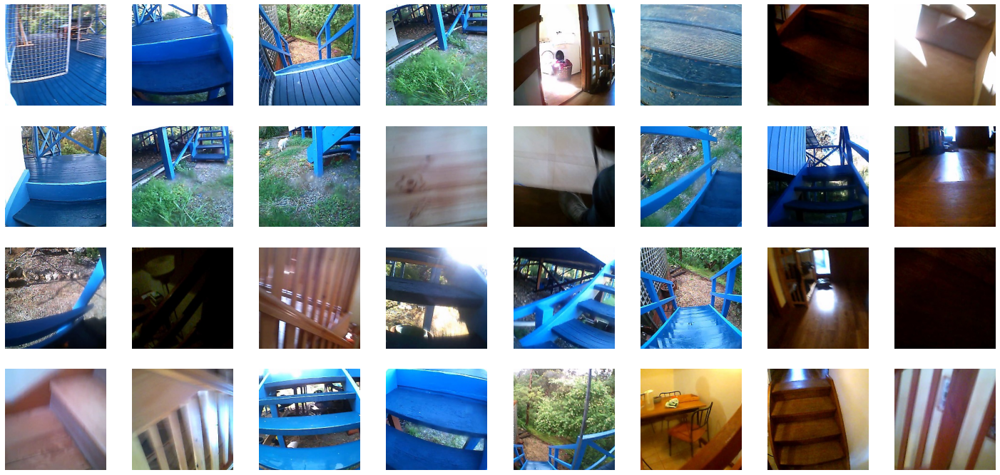

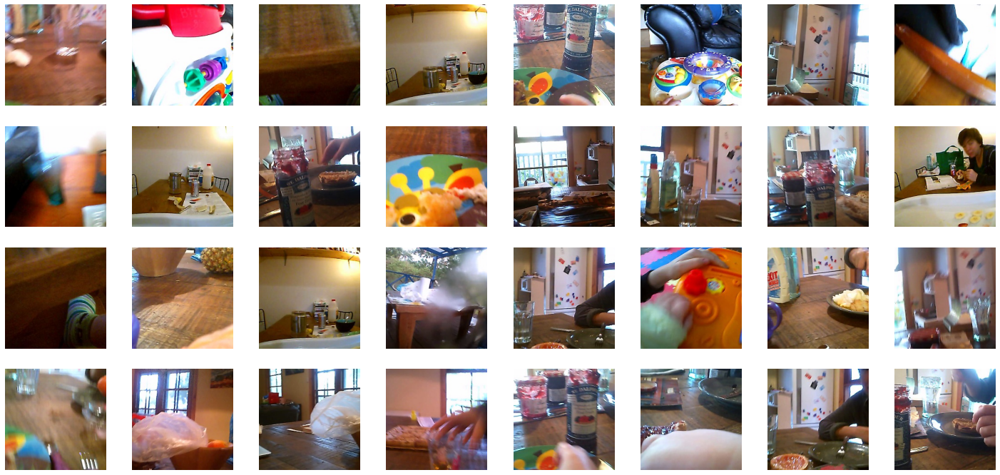

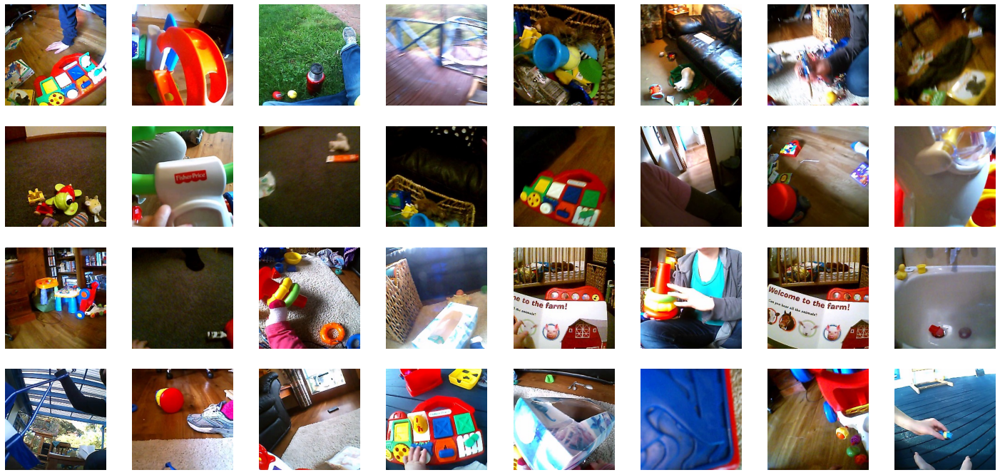

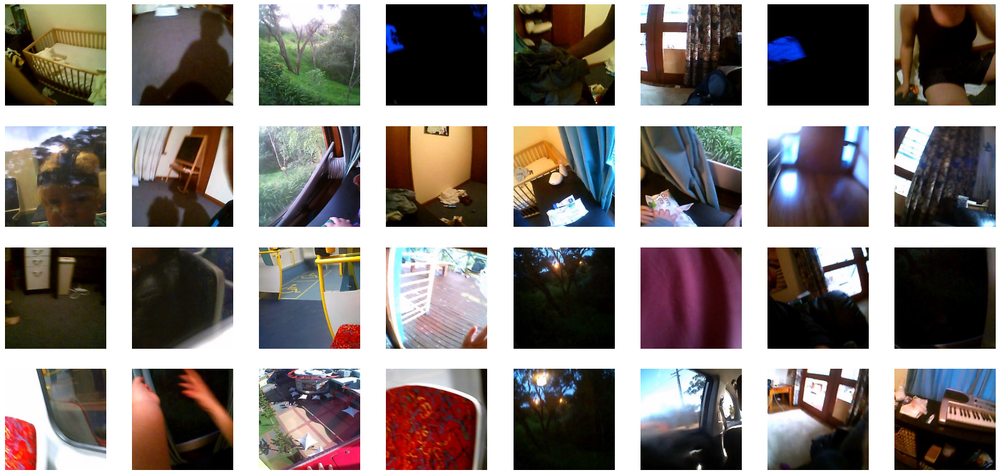

In [29]:
for eval_category in eval_categories:
    category_frames = sims_df[sims_df['target_category'] == eval_category]

    # sort ball frames data frame by highest "sim" and only keep the top X% based on sim
    # threshold = 0.15
    # category_frames = category_frames.sort_values(by=['sim'], ascending=False).head(int(len(category_frames)*threshold)).reset_index()

    # get subset of ball_frames where sim is greater than 30
    # ball_frames = ball_frames[ball_frames['sim'] > 30]

    print(eval_category, len(category_frames))

    subset = category_frames.sample(min(32, len(category_frames)))['frame'].tolist()

    plt.figure(figsize=(25, 12))
    for i, frame in enumerate(subset):
        plt.subplot(4, 8, i+1)
        I = Image.open(frame)
        plt.imshow(I)
        plt.axis('off')
        plt.savefig(f"{eval_category}.png")

In [33]:
!zip -r frames.zip frames

  adding: frames/ (stored 0%)
  adding: frames/ball_filtered.png (deflated 1%)
  adding: frames/ball.png (deflated 0%)
  adding: frames/basket_filtered.png (deflated 1%)
  adding: frames/basket.png (deflated 0%)
  adding: frames/car_filtered.png (deflated 1%)
  adding: frames/car.png (deflated 1%)
  adding: frames/cat_filtered.png (deflated 1%)
  adding: frames/cat.png (deflated 0%)
  adding: frames/chair_filtered.png (deflated 1%)
  adding: frames/chair.png (deflated 0%)
  adding: frames/computer_filtered.png (deflated 1%)
  adding: frames/computer.png (deflated 0%)
  adding: frames/crib_filtered.png (deflated 0%)
  adding: frames/crib.png (deflated 0%)
  adding: frames/door_filtered.png (deflated 1%)
  adding: frames/door.png (deflated 0%)
  adding: frames/floor_filtered.png (deflated 1%)
  adding: frames/floor.png (deflated 1%)
  adding: frames/foot_filtered.png (deflated 1%)
  adding: frames/foot.png (deflated 0%)
  adding: frames/ground_filtered.png (deflated 0%)
  adding: frames/

In [13]:
from multimodal.multimodal_saycam_data_module import DATA_DIR, EXTRACTED_FRAMES_DIRNAME

with open(DATA_DIR / "train.json") as f:
    train_data = json.load(f)
    train_data = train_data["data"]
    
with open(DATA_DIR / "train_shuffled.json") as f:
    train_shuffled_data = json.load(f)
    train_shuffled_data = train_shuffled_data["data"]        

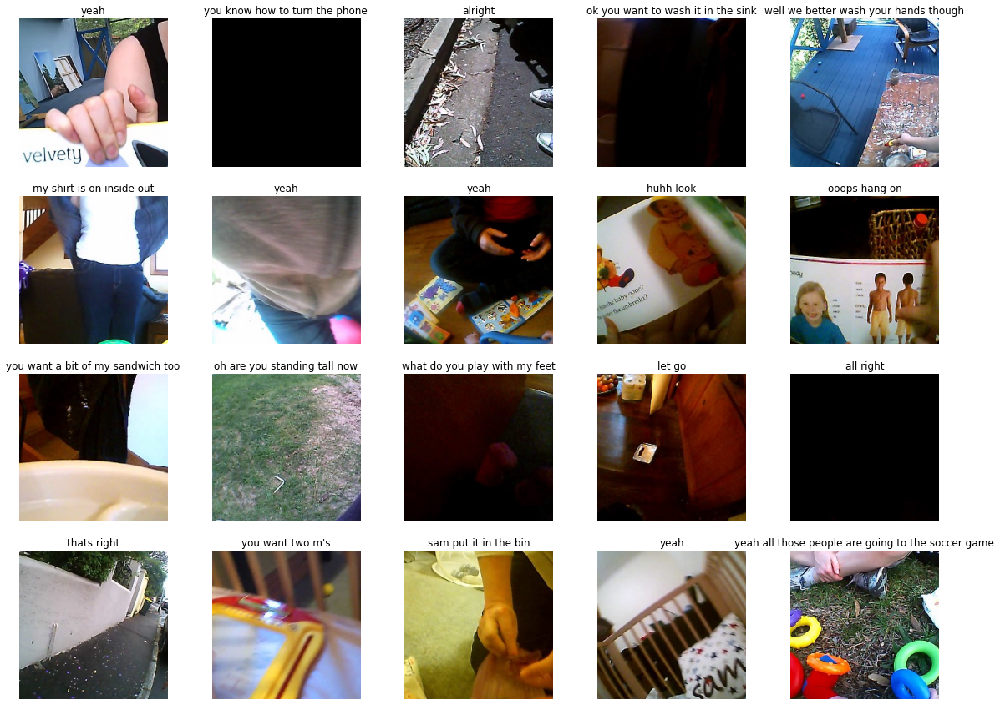

In [21]:
plt.figure(figsize=(20, 15))
for i in range(20):
    frame = os.path.join(EXTRACTED_FRAMES_DIRNAME, train_data[i]['frame_filenames'][0])
    plt.subplot(4, 5, i+1)
    I = Image.open(frame)
    plt.title(train_data[i]["utterance"])
    plt.imshow(I)
    plt.axis('off')


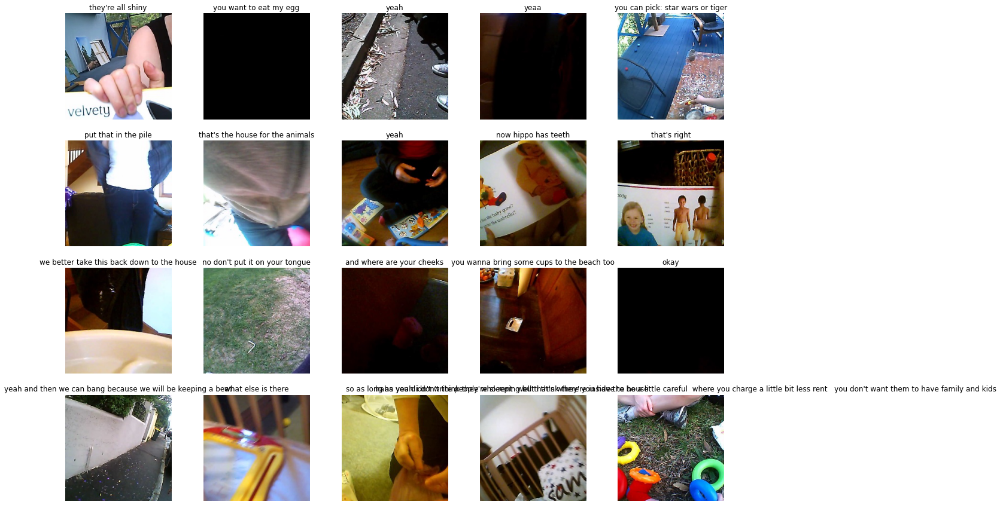

In [22]:
plt.figure(figsize=(20, 15))
for i in range(20):
    frame = os.path.join(EXTRACTED_FRAMES_DIRNAME, train_shuffled_data[i]['frame_filenames'][0])
    plt.subplot(4, 5, i+1)
    I = Image.open(frame)
    plt.title(train_shuffled_data[i]["utterance"])
    plt.imshow(I)
    plt.axis('off')

In [25]:
train_utterances = [trial['utterance'] for trial in train_data]
train_shuffled_utterances = [trial['utterance'] for trial in train_shuffled_data]

In [27]:
sorted(train_utterances) == sorted(train_shuffled_utterances)

True